###CLIP(Constrastive Language-Image Pretraining)
- it is a multi model AI model developed by OpenAI that can have both images and texts as input and can process to connect them
- They have two encoder in the structure. one is Text encoder for sentence(GPT or BERT) or phrases, and another is Image encoder(Vit or ResNet) for processing image. both convert their raw data into embedding vectors and find a similarity using cosine similarity



## Package explanation
- torch : deep learning framework
- torchvision : imamge processing tool
- transformers : pre-defined model library in Huggingface
- pillow : image processing

In [2]:
!pip install torch torchvision transformers pillow

In [5]:
import torch
from PIL import Image
from transformers import CLIPProcessor, CLIPModel
from io import BytesIO
import requests

In [2]:
# load model and processor
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")
model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.
/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

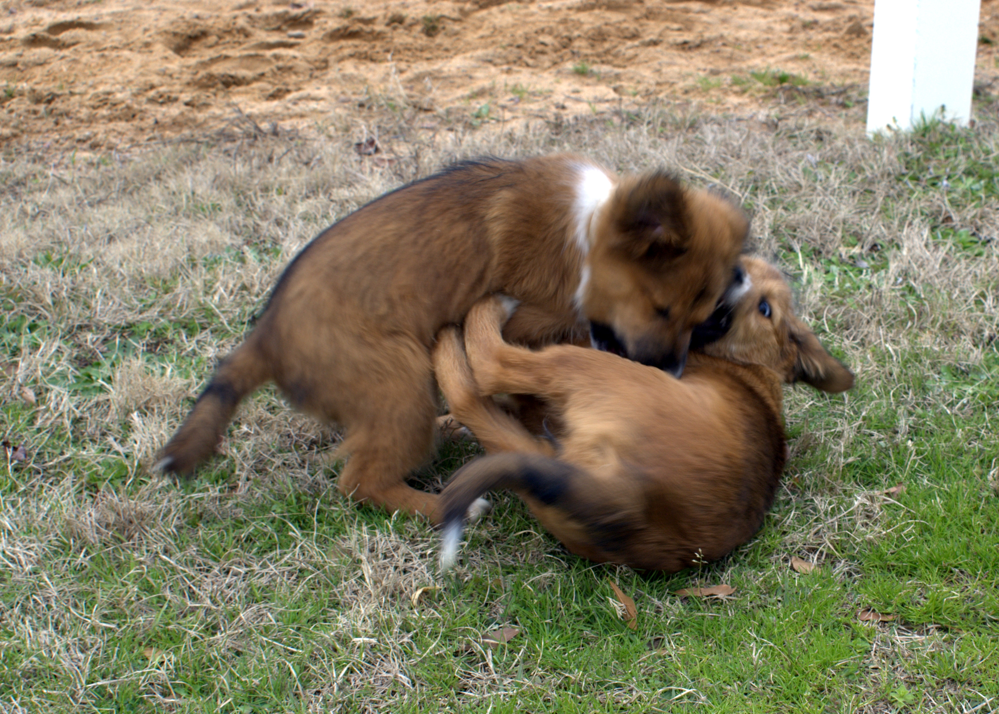

In [7]:
url = "https://upload.wikimedia.org/wikipedia/commons/9/9d/Puppies_Wrestling.jpg"
headers = {
    "User-Agent": "Mozilla/5.0"  #act like agent not being like robot.
}
response = requests.get(url, headers=headers)
img = Image.open(BytesIO(response.content)) # Byte -> object
display(img)

In [11]:
# define the candidates of text for classifying the image
texts = ["the dogs are playing each other", "the dogs are sitting", "the cats are fighting"]

# put image and text to model
inputs = processor(text=texts, images=img, return_tensors="pt", padding =True)
outputs = model(**inputs)

# calculate similarity between image and text
logits = outputs.logits_per_image
probs = logits.softmax(dim=1)

for t, p in zip(texts,probs[0]):
  print(f"'{t}' : probability ={p.item():4f}")

'the dogs are playing each other' : probability =0.990925
'the dogs are sitting' : probability =0.006476
'the cats are fighting' : probability =0.002599


it almost perfectly predict relation between text and image. but there are still limitations, especially capturing the small detail, abstract object, OCR, understanding the context. the below is the one of the case that fails to capture small detail. Although dog has a little bit larger head, they predict almost same and even give more probability that predict larger head of cat

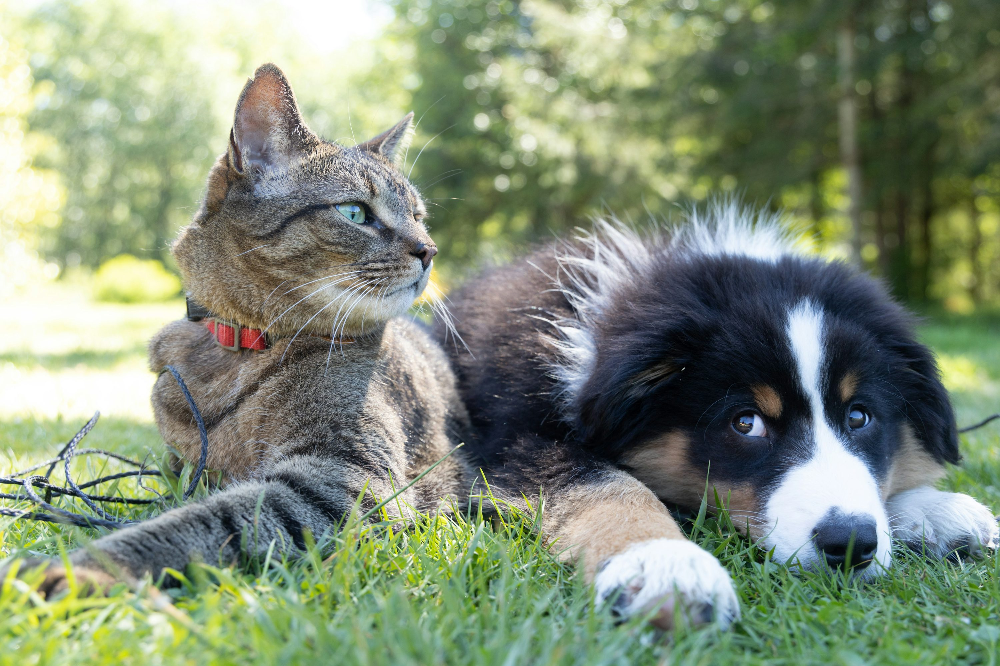

In [12]:
url = "https://images.unsplash.com/photo-1623387641168-d9803ddd3f35?fm=jpg&q=60&w=3000&ixlib=rb-4.1.0&ixid=M3wxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8fA%3D%3D"
headers = {
    "User-Agent": "Mozilla/5.0"  #act like agent not being like robot.
}
response = requests.get(url, headers=headers)
img = Image.open(BytesIO(response.content)) # Byte -> object
display(img)


In [13]:
# define the candidates of text for classifying the image
texts = ["the dog has bigger head than cat", "cat has bigger head than dog"]

# put image and text to model
inputs = processor(text=texts, images=img, return_tensors="pt", padding =True)
outputs = model(**inputs)

# calculate similarity between image and text
logits = outputs.logits_per_image
probs = logits.softmax(dim=1)

for t, p in zip(texts,probs[0]):
  print(f"'{t}' : probability ={p.item():4f}")

'the dog has bigger head than cat' : probability =0.458020
'cat has bigger head than dog' : probability =0.541980
